In [1]:
import networkx as nx
import matplotlib.pyplot as plt
from scipy.stats import spearmanr
import pandas as pd

def partial_spearman_corr(df, x, y, controls):
    """Compute partial Spearman correlation between x and y given selected control variables."""
    from statsmodels.api import OLS, add_constant
    
    if controls:
        # Regress x and y on control variables
        residual_x = OLS(df[x], add_constant(df[controls])).fit().resid
        residual_y = OLS(df[y], add_constant(df[controls])).fit().resid
        return spearmanr(residual_x, residual_y)[0]
    else:
        return spearmanr(df[x], df[y])[0]

In [112]:
# horiz
import matplotlib.patches as mpatches

def plot_causal_graph(adj_matrix, df, ci_test):
    """
    Plots causal graph with edge color based on partial Spearman correlation values.
    Uses only relevant control variables.
    Displays actual correlation values (+/-0.XX) beside the edges.
    """
    nodes = df.columns
    G = nx.DiGraph()
    edge_info = []
    edge_labels = {}

    for i in range(len(nodes)):
        for j in range(len(nodes)):
            if adj_matrix[i, j] != 0:
                cause = nodes[i]
                effect = nodes[j]
                
                # Identify control variables (parents of cause or effect)
                related_vars = [nodes[k] for k in range(len(nodes)) if adj_matrix[k, j] or adj_matrix[k, i]]
                controls = [var for var in related_vars if var not in [cause, effect]]

                # Compute partial Spearman correlation
                pcorr = partial_spearman_corr(df, cause, effect, controls)

                # Determine edge color and width
                edge_color = '#F2C14E' if pcorr > 0 else '#8e7dbe'
                edge_width = 1 + 2 * abs(pcorr)

                G.add_edge(cause, effect, weight=pcorr)
                edge_info.append((cause, effect, edge_color, edge_width))

                # Add edge label with formatted value
                edge_labels[(cause, effect)] = f"{pcorr:+.2f}"

   # Layout
    pos = nx.circular_layout(G)
    label_pos = {n: (p[0] * 1.285, p[1] * 1.285) for n, p in pos.items()}

    plt.figure(figsize=(11, 11),dpi=900)

    node_colors = ['#C9BFE1'] # default purple

    nx.draw_networkx_nodes(
        G, pos,
        node_color=node_colors,
        edgecolors='white',
        node_size=500,
        alpha=0.9
    )
    nx.draw_networkx_labels(G, label_pos, font_size=16,font_family="arial", font_color='black')

   

    # Draw edges
    arc_rad = 0.1
    for u, v, color, width in edge_info:
        nx.draw_networkx_edges(
            G, pos, edgelist=[(u, v)], width=width, edge_color=color,
            arrowstyle='simple', arrowsize=20, connectionstyle=f'arc3,rad={arc_rad}',
            min_source_margin=20, min_target_margin=20
        )

    # 准备边标签（显示相关系数）
    edge_labels = {
        (u, v): f"{G[u][v] ['weight']:+.2f}" for u, v in G.edges()
    }

    # 使用 NetworkX 的内置方法绘制边标签（加上旋转控制和透明背景）
    nx.draw_networkx_edge_labels(
        G, pos,
        edge_labels=edge_labels,
        font_size=14,
        font_color='black',
        font_family="arial",
        rotate=True,
        label_pos=0.5,
        bbox=dict(facecolor='none', edgecolor='none', pad=0)
    )

    # Add legend
    pos_patch = mpatches.Patch(color='#F2C14E', label='Positive Causality')
    neg_patch = mpatches.Patch(color='#8e7dbe', label='Negative Causality')
    plt.legend(handles=[pos_patch, neg_patch], loc='lower left', fontsize=14, frameon=False)

    plt.gca().margins(x=0.3, y=0.3)
    plt.axis('off')
    plt.show()

In [131]:
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

def plot_causal_graph(adj_matrix, df, ci_test):
    """
    Plots causal graph with edge color based on partial Spearman correlation values.
    Uses only relevant control variables.
    Displays actual correlation values (+/-0.XX) beside the edges.
    Draws arrows for one-way edges and lines for undirected (symmetric) edges.
    """
    nodes = df.columns
    G = nx.DiGraph()
    edge_info = []
    edge_labels = {}

    # Loop through all pairs
    for i in range(len(nodes)):
        for j in range(len(nodes)):
            if adj_matrix[i, j] != 0:
                node_i = nodes[i]
                node_j = nodes[j]

                # Identify control variables
                related_vars = [nodes[k] for k in range(len(nodes)) if adj_matrix[k, j] or adj_matrix[k, i]]
                controls = [var for var in related_vars if var not in [node_i, node_j]]

                # Compute partial Spearman correlation
                pcorr = partial_spearman_corr(df, node_i, node_j, controls)

                # Determine edge color and width
                edge_color = '#F2C14E' if pcorr > 0 else '#8e7dbe'
                edge_width = 1 + 2 * abs(pcorr)

                G.add_edge(node_i, node_j, weight=pcorr)
                edge_info.append((node_i, node_j, edge_color, edge_width))
                edge_labels[(node_i, node_j)] = f"{pcorr:+.2f}"

    pos = nx.circular_layout(G)
    label_pos = {n: (p[0] * 1.285, p[1] * 1.285) for n, p in pos.items()}

    plt.figure(figsize=(11, 11), dpi=900)
    node_colors = ['#C9BFE1']  # default purple

    nx.draw_networkx_nodes(
        G, pos,
        node_color=node_colors,
        edgecolors='white',
        node_size=500,
        alpha=0.9
    )
    nx.draw_networkx_labels(G, label_pos, font_size=16, font_family="arial", font_color='black')

    # Draw edges: check for symmetric edges
    handled_edges = set()
    for u, v, color, width in edge_info:
        if (v, u) in handled_edges:
            continue  # already handled symmetric pair

        arc_rad = 0.1

        if G.has_edge(v, u):
            
            # symmetric → undirected style
            nx.draw_networkx_edges(
            G, pos, edgelist=[(u, v)], width=width, edge_color=color,
            arrowstyle='-', arrowsize=20, connectionstyle=f'arc3,rad={arc_rad}',
            min_source_margin=20, min_target_margin=20
            )
            handled_edges.add((u, v))
        else:
            # one-way → directed arrow
            nx.draw_networkx_edges(
            G, pos, edgelist=[(u, v)], width=width, edge_color=color,
            arrowstyle='simple', arrowsize=20, connectionstyle=f'arc3,rad={arc_rad}',
            min_source_margin=20, min_target_margin=20
            )
            handled_edges.add((u, v))

    # Edge labels
    nx.draw_networkx_edge_labels(
        G, pos,
        edge_labels=edge_labels,
        font_size=14,
        font_color='black',
        font_family="arial",
        rotate=True,
        label_pos=0.5,
        bbox=dict(facecolor='none', edgecolor='none', pad=0)
    )

    # Legend
    pos_patch = mpatches.Patch(color='#F2C14E', label='Positive Causality')
    neg_patch = mpatches.Patch(color='#8e7dbe', label='Negative Causality')
    plt.legend(handles=[pos_patch, neg_patch], loc='lower left', fontsize=14, frameon=False)

    plt.gca().margins(x=0.3, y=0.3)
    plt.axis('off')
    plt.show()

In [9]:
import numpy as np
import pandas as pd
from pc_gcastle import PC
from random import shuffle

def run_pc_analysis(df, factor_list, alpha=0.05, shuffle_factors=False, ci_test='spearman'):
    """
    Run PC algorithm for a selected subset of factors.
    
    Parameters:
        df (pd.DataFrame): Original dataframe containing 'factor', 'cbsacode', and 'SSAMI'.
        factor_list (list): List of factor names to include in the analysis.
        alpha (float): Significance level for conditional independence tests.
        shuffle_factors (bool): Whether to shuffle the factor list randomly.
    
    Returns:
        pc (PC object): The trained PC model.
    """
    
    if shuffle_factors:
        shuffle(factor_list)
    
    # Filter and pivot
    df_select = df.loc[df['factor'].isin(factor_list)]
    sami_col = df_select.columns[df_select.columns.str.contains("SAMI", case=False)][0]

    dfp = df_select.pivot(index=["cbsacode",'Year'], columns="factor", values=sami_col).reset_index()
    df_cleaned = dfp.drop(columns=["cbsacode",'Year'])  # Reverse column order as in original code
    data_matrix = df_cleaned.to_numpy()

    # Run PC algorithm
    pc = PC(variant='stable', alpha=alpha, ci_test = ci_test)
    pc.learn(data_matrix, columns=df_cleaned.columns)

    result = pc._results
    
    print("Learned skeleton (CPDAG):")
    plot_causal_graph(pc.causal_matrix, df_cleaned,ci_test)
    
    return result

In [14]:
def run_pc_with_stability(df, factor_list, alpha=0.01, ci_test='spearman',
                          n_runs=20, stability_threshold=0.8, verbose=True):
    """
    Run PC multiple times with shuffled factor orders and return stable edges.
    
    Returns:
        stable_adj: binary adjacency matrix of stable edges
        edge_freq: frequency matrix (values in [0,1])
        final_graph: last PC object (optional use)
    """
    num_vars = len(factor_list)
    edge_counts = np.zeros((num_vars, num_vars))
    sami_col = df.columns[df.columns.str.contains("SAMI", case=False)][0]

    for run in range(n_runs):
        shuffled = factor_list.copy()
        shuffle(shuffled)

        # Pivot and prepare matrix
        df_sub = df[df['factor'].isin(shuffled)]
        dfp = df_sub.pivot(index=['cbsacode', 'Year'], columns='factor', values=sami_col).reset_index()
        dfp = dfp.sort_values(['cbsacode', 'Year'])
        df_clean = dfp.drop(columns=['cbsacode', 'Year'])
        data_matrix = df_clean.to_numpy()

        # Run PC
        pc = PC(variant='stable', alpha=alpha, ci_test=ci_test)
        pc.learn(data_matrix, columns=df_clean.columns)

        # Count edge presence
        edge_counts += (pc.causal_matrix != 0).astype(int)

        if verbose:
            print(f"Run {run+1}/{n_runs} complete.")

    # Frequency matrix (how often each edge appears)
    edge_freq = edge_counts / n_runs

    # Threshold to keep only stable edges
    stable_adj = (edge_freq >= stability_threshold).astype(int)

    return stable_adj, edge_freq

In [97]:
df

,Year,cbsacode,Sample_Size,population,adult_smoking,adult_obesity,excessive_drinking,diabetes_prevalence,no_time_activity,some_college,...,Park_Area_Acres,Weighted_RESP,noise70n,noise80n,noise90n,smo_obe_dia,smo_obe,smo_dia,obe_dia,depressed
0,2011,10740,2880,857903.0,123687.787094,1.357007e+05,85547.993919,38302.509293,117481.0,143682.0,...,36984.815680,0.145476,5540.745134,1224.879163,17.445337,-0.834472,-0.653402,-0.650231,-0.739975,186851.2734
1,2011,11260,482,374553.0,58399.185228,7.407142e+04,49694.181724,18560.182330,58051.0,70584.0,...,926977.937800,0.225587,0.000000,0.000000,0.000000,-1.062247,-0.867516,-0.853160,-0.881160,65696.5962
2,2011,12060,15892,5503952.0,688901.435410,1.063977e+06,605445.249041,382898.985792,848352.0,1066375.0,...,139783.192000,0.407443,38628.932617,8411.143736,261.181207,2.003696,1.688192,1.678403,1.542099,740281.5440
3,2011,12260,1442,547067.0,88740.928716,1.282184e+05,56390.564574,46079.670066,108477.0,78056.0,...,3976.123756,0.400427,1531.976762,40.122342,4.028891,-0.881270,-0.736481,-0.698454,-0.723619,85397.1587
4,2011,12420,1205,1705075.0,227276.255641,3.056785e+05,258215.965344,89557.563452,239279.0,374121.0,...,110240.428200,0.206397,22763.419503,4618.338378,191.106168,-0.346458,-0.224436,-0.262635,-0.361099,268719.8200
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
859,2022,45820,1345,230878.0,30858.951001,6.751237e+04,32694.785366,18218.266001,40349.0,36382.0,...,2688.897811,0.266275,1540.361169,109.303096,9.307088,-1.117193,-0.933806,-0.912468,-0.890394,51901.3744
860,2022,46140,2331,1006411.0,142723.974003,2.745027e+05,108317.909984,81929.391002,195032.0,164229.0,...,15836.640480,0.301938,7864.949017,620.703682,47.292402,-0.544005,-0.441602,-0.466376,-0.424753,291557.2667
861,2022,47260,8550,1760740.0,235602.113995,4.751754e+05,257462.399611,148211.222997,298008.0,351364.0,...,182047.374800,0.280688,1070.215714,107.331962,17.094573,-0.002970,0.002682,-0.051933,0.041543,400216.2020
862,2022,48620,1516,643768.0,82246.350996,1.816031e+05,81941.549291,51666.979998,114980.0,113437.0,...,10427.746640,0.313956,5302.334212,361.131273,60.846898,-0.823419,-0.684208,-0.693779,-0.639230,132873.7152


In [156]:
import pandas as pd
import statsmodels.api as sm
import statsmodels.formula.api as smf

# Load your data
df = pd.read_csv('../00_data/03_analysis_data/all_factor_72_12.csv')

# List of your 7 factor columns
factors = [
    'gdp', 
    'Park_Area_Acres', 
    'noise90n', 
    'smo_obe_dia', 
    'depressed',
    'mental_health_providers',
    'no_time_activity'
]

# Prepare summary list
summary_list = []

summary_list = []

for factor in factors:
    try:
        df_nonmissing = df.dropna(subset=[factor])
        total_var = df_nonmissing[factor].var()
        
        # Between-location variance (CBSA means)
        loc_means = df_nonmissing.groupby('cbsacode')[factor].mean()
        loc_var = loc_means.var()
        
        # Between-year variance (Year means)
        year_means = df_nonmissing.groupby('Year')[factor].mean()
        year_var = year_means.var()
        
        # Residual variance
        residual_var = total_var - loc_var - year_var
        residual_var = max(residual_var, 0)
        
        # Proportions
        space_pct = loc_var / total_var * 100 if total_var != 0 else 0
        time_pct = year_var / total_var * 100 if total_var != 0 else 0
        resid_pct = residual_var / total_var * 100 if total_var != 0 else 0
        
        # Compare CBSA vs Year effect
        stronger_effect = 'CBSA' if loc_var > year_var else 'Year'
        
        summary_list.append({
            'factor': factor,
            'space_var_pct': space_pct,
            'time_var_pct': time_pct,
            'residual_var_pct': resid_pct,
            'stronger_effect': stronger_effect
        })
        
        print(f"✅ Done: {factor}")
        
    except Exception as e:
        print(f"❌ Failed on {factor}: {e}")

# Compile summary
summary_df = pd.DataFrame(summary_list)

# Save to CSV (optional)
# summary_df.to_csv('variance_decomposition_summary.csv', index=False)

✅ Done: gdp
✅ Done: Park_Area_Acres
✅ Done: noise90n
✅ Done: smo_obe_dia
✅ Done: depressed
✅ Done: mental_health_providers
✅ Done: no_time_activity


In [158]:
import pandas as pd

def compute_marginal_conditional_r2(model_result):
    """
    Calculate marginal and conditional R² for a statsmodels MixedLM result.

    Parameters:
    -----------
    model_result : statsmodels MixedLMResults object

    Returns:
    --------
    r2_marginal : float
        R² for fixed effects only.
    r2_conditional : float
        R² for fixed + random effects.
    """
    # Fixed effects variance (variance of fitted values)
    var_fixed = np.var(model_result.fittedvalues)

    # Random effects variance
    # Access the random intercept variance (scalar)
    if hasattr(model_result, 'cov_re') and model_result.cov_re.shape[0] > 0:
        re_var = np.diag(model_result.cov_re).sum()
    else:
        re_var = 0.0

    # Residual variance
    var_residual = model_result.scale

    # Total variance
    var_total = var_fixed + re_var + var_residual

    # Marginal R² = fixed / total
    r2_marginal = var_fixed / var_total if var_total > 0 else np.nan

    # Conditional R² = (fixed + random) / total
    r2_conditional = (var_fixed + re_var) / var_total if var_total > 0 else np.nan

    return r2_marginal, r2_conditional

In [159]:
import pandas as pd
import statsmodels.formula.api as smf
from scipy.stats import chi2
import numpy as np

lrt_results = []

for factor in factors:
    try:
        df_nonmissing = df.dropna(subset=[factor])

        # CBSA model
        m1 = smf.mixedlm(f"{factor} ~ 1", df_nonmissing, groups=df_nonmissing["cbsacode"])
        r1 = m1.fit()
        r2_marginal_cbsa, r2_conditional_cbsa = compute_marginal_conditional_r2(r1)

        # Year model
        m2 = smf.mixedlm(f"{factor} ~ 1", df_nonmissing, groups=df_nonmissing["Year"])
        r2 = m2.fit()
        r2_marginal_year, r2_conditional_year = compute_marginal_conditional_r2(r2)

        # LRT
        lr_stat = 2 * (r1.llf - r2.llf)
        p_value = chi2.sf(abs(lr_stat), df=1)
        stronger = 'CBSA' if r1.llf > r2.llf else 'Year'

        # Variance components and random SD
        cbsa_var = r1.cov_re.iloc[0, 0] if r1.cov_re.size > 0 else np.nan
        year_var = r2.cov_re.iloc[0, 0] if r2.cov_re.size > 0 else np.nan
        cbsa_sd = np.sqrt(cbsa_var) if cbsa_var >= 0 else np.nan
        year_sd = np.sqrt(year_var) if year_var >= 0 else np.nan

        # Flags for near-zero random effects
        cbsa_flag = 'singular' if cbsa_var < 1e-6 else 'ok'
        year_flag = 'singular' if year_var < 1e-6 else 'ok'

        lrt_results.append({
            'factor': factor,
            'CBSA_logLik': r1.llf,
            'Year_logLik': r2.llf,
            'CBSA_R2_marginal': r2_marginal_cbsa,
            'CBSA_R2_conditional': r2_conditional_cbsa,
            'Year_R2_marginal': r2_marginal_year,
            'Year_R2_conditional': r2_conditional_year,
            'CBSA_var': cbsa_var,
            'Year_var': year_var,
            'CBSA_random_sd': cbsa_sd,
            'Year_random_sd': year_sd,
            'CBSA_flag': cbsa_flag,
            'Year_flag': year_flag,
            'LR_stat': lr_stat,
            'p_value': p_value,
            'stronger_effect': stronger
        })

        print(f"✅ LRT done: {factor}")

    except Exception as e:
        print(f"❌ Failed on {factor}: {e}")

# Convert to DataFrame
lrt_df = pd.DataFrame(lrt_results)


/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)


✅ LRT done: gdp


/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/sit

✅ LRT done: Park_Area_Acres


/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


✅ LRT done: noise90n


/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/stat

✅ LRT done: smo_obe_dia


/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/sit

✅ LRT done: depressed
✅ LRT done: mental_health_providers
✅ LRT done: no_time_activity


/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/Users/lidouhao/anaconda3/envs/capstone_depression/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


In [161]:
lrt_df.to_csv('mix_effect_model.csv',index=False)

In [169]:
lrt_df

,factor,CBSA_logLik,Year_logLik,CBSA_R2_marginal,CBSA_R2_conditional,Year_R2_marginal,Year_R2_conditional,CBSA_var,Year_var,CBSA_random_sd,Year_random_sd,CBSA_flag,Year_flag,LR_stat,p_value,stronger_effect,CBSA_lower,CBSA_upper,Year_lower,Year_upper
0,gdp,-16667.317383,-17922.196775,0.487328,0.982931,6.094694e-18,3.802169e-10,6.209556e+16,2.412232e+07,2.491898e+08,4.911447e+03,ok,ok,2509.758784,0.000000e+00,CBSA,2.003486e+08,2.980310e+08,3.948804e+03,5.874091e+03
1,Park_Area_Acres,-2536.067347,-12784.221436,0.922998,1.000000,3.144154e-29,3.080764e-07,3.564144e+10,1.317638e+05,1.887894e+05,3.629928e+02,ok,ok,20496.308178,0.000000e+00,CBSA,1.517867e+05,2.257921e+05,2.918462e+02,4.341394e+02
2,noise90n,3743.453587,-6504.720596,0.922995,1.000000,3.488065e-29,5.782432e-05,1.705141e+04,1.183265e+01,1.305810e+02,3.439862e+00,ok,ok,20496.348366,0.000000e+00,CBSA,1.049872e+02,1.561749e+02,2.765649e+00,4.114075e+00
3,smo_obe_dia,261.097290,-1698.362201,0.495374,0.997167,7.308264e-35,1.550271e-33,2.991553e+00,4.394605e-33,1.729611e+00,6.629182e-17,ok,singular,3918.918983,0.000000e+00,CBSA,1.390607e+00,2.068614e+00,5.329862e-17,7.928501e-17
4,depressed,-11086.150801,-12428.928832,0.489197,0.986387,1.569782e-11,7.151166e-07,1.850159e+11,1.342491e+05,4.301348e+05,3.664002e+02,ok,ok,2685.556061,0.000000e+00,CBSA,3.458284e+05,5.144412e+05,2.945858e+02,4.382147e+02
5,mental_health_providers,-8421.040370,-8882.918702,0.421341,0.859948,4.644608e-02,1.074186e-01,4.026912e+07,3.382303e+06,6.345796e+03,1.839104e+03,ok,ok,923.756664,6.721737e-203,CBSA,5.102020e+03,7.589571e+03,1.478640e+03,2.199568e+03
6,no_time_activity,-10226.856154,-12552.002173,0.496307,0.998877,5.491517e-13,7.689736e-07,2.519396e+11,1.920108e+05,5.019358e+05,4.381904e+02,ok,ok,4650.292038,0.000000e+00,CBSA,4.035564e+05,6.003153e+05,3.523050e+02,5.240757e+02


/var/folders/xn/k3tchqyx5bn081b3tlx0k4940000gn/T/ipykernel_15643/2695702819.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=0)


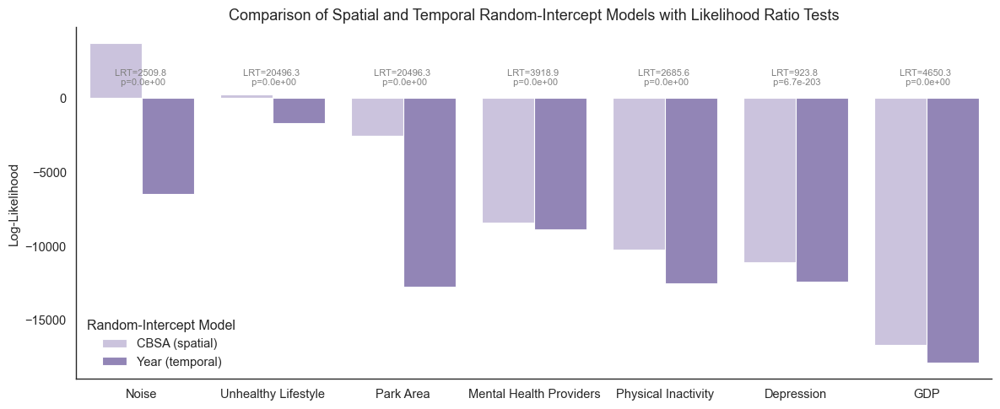

In [220]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Replace factor names for clarity
df['factor'] = df['factor'].replace({
    'Park_Area_Acres': 'Park Area',
    'noise90n': 'Noise',
    'no_time_activity': 'Physical Inactivity',
    'smo_obe_dia': 'Unhealthy Lifestyle',
    'depressed': 'Depression',
    'gdp': 'GDP',
    'mental_health_providers': 'Mental Health Providers',
    'driving_alone_to_work': 'Driving Alone to Work'
})

# Sort factors by CBSA logLik
df = df.sort_values('CBSA_logLik', ascending=False)

# Melt dataframe
df_melted = df.melt(id_vars=['factor', 'p_value', 'LR_stat'], 
                    value_vars=['CBSA_logLik', 'Year_logLik'], 
                    var_name='Model', value_name='LogLik')

# Define academic style
sns.set_context("paper", font_scale=1.2)
sns.set_style("white")

# Define colors and legend labels
palette = {'CBSA_logLik': '#C9BFE1', 'Year_logLik': '#8e7dbe'}
legend_labels = {'CBSA_logLik': 'CBSA (spatial)', 'Year_logLik': 'Year (temporal)'}

# Initialize plot
plt.figure(figsize=(12, 5))
ax = sns.barplot(data=df_melted, x='factor', y='LogLik', hue='Model', palette=palette)

# Add LRT and p-value annotations at bottom
for idx, row in df.iterrows():
    xpos = idx
    ymin = min(row['CBSA_logLik'], row['Year_logLik'])
    ax.text(xpos, 2000,  # fixed position at bottom
            f"LRT={row['LR_stat']:.1f} \n p={row['p_value']:.1e}",
            ha='center', va='top', fontsize=8, color='gray')

# Clean up plot appearance
ax.set_ylabel('Log-Likelihood', fontsize=11)
ax.set_xlabel('')
ax.set_title('Comparison of Spatial and Temporal Random-Intercept Models with Likelihood Ratio Tests', fontsize=13)
ax.set_xticklabels(ax.get_xticklabels(), rotation=0)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Fix legend with correct color boxes and labels
handles, labels = ax.get_legend_handles_labels()
new_labels = [legend_labels[label] for label in labels]
ax.legend(handles, new_labels, title='Random-Intercept Model', loc='lower left', frameon=False)

plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Assume df has: ['factor', 'cbsacode', 'Year', 'SSAMI', 'detrended', 'adf_p']

# Sort factors and CBSAs
factors = my_factors       # 7 factors → columns
locations = sorted(df['cbsacode'].unique())    # 72 CBSAs → rows

# Split CBSA list into 12 chunks (6 per page)
chunks = [locations[i:i + 6] for i in range(0, len(locations),6)]

# Loop over chunks
for chunk_idx, chunk in enumerate(chunks):
    nrows = len(chunk)
    ncols = len(factors)
    
    fig, axes = plt.subplots(nrows, ncols, figsize=(ncols * 2, nrows * 1), sharex=False, sharey=False)
    if nrows == 1:
        axes = np.expand_dims(axes, axis=0)
    if ncols == 1:
        axes = np.expand_dims(axes, axis=1)
    
    for i, loc in enumerate(chunk):
        for j, factor in enumerate(factors):
            ax = axes[i, j]
            subset = df[(df['factor'] == factor) & (df['cbsacode'] == loc)]
            if subset.empty:
                ax.axis('off')
                continue
            
            x = np.arange(len(subset))
            y = subset['SSAMI'].values
            coeffs = np.polyfit(x, y, 1)
            trend = np.polyval(coeffs, x)
            
            ax.plot(subset['Year'], y, linewidth=1)
            ax.plot(subset['Year'], subset['detrended'], linewidth=1)
            ax.plot(subset['Year'], trend, linestyle='--', color='black', linewidth=1)
            
            if i == 0:
                ax.set_title(factor, fontsize=6)
            if j == 0:
                ax.set_ylabel(loc, fontsize=5)
            
            ax.set_xticks([])
            ax.set_yticks([])
            
            # Add red border if non-stationary (p ≥ 0.05)
            adf_p = subset['adf_p_final'].iloc[0]
            if adf_p >= 0.05:
                for spine in ax.spines.values():
                    spine.set_edgecolor('red')
                    spine.set_linewidth(1.5)
    
    # Add legend once on top
    handles, labels = ax.get_legend_handles_labels()
    fig.legend(handles, labels, loc='upper center', ncol=3, fontsize=6)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    
    # Save each chunk
    plt.savefig(f'panel_chunk_{chunk_idx + 1}_redbox.png', dpi=600, bbox_inches='tight')
    plt.close()

# Detrend


In [60]:
my_factors = ['Depression',

    # health
    # 'excessive_drinking',
    # 'adult_obesity',
    # 'sti', 
    'Unhealthy Lifestyle',
    # 'smo_obe', 
    # 'smo_dia', 
    # 'obe_dia', 
     'Mental Health Providers', 
     'Physical Inactivity',

    # education
    # 'some_college',

    # economic
    # 'unemployment', #no direct link with depression
    'GDP', 
    # 'median_household_income', #add this the no time activity become result

    # health source
    'Noise', 

    # social association
    # 'children_single_parent',

    # enviroment
    # 'driving_alone_to_work', 
    # 'Driving Alone to Work',
    'Park Area',
    # 'Weighted_RESP', 
    # 'noise70n', 
    # 'noise80n', 
]

In [91]:
df = pd.read_csv('../00_data/03_analysis_data/detrend_result_0508_arima.csv')
df.loc[df['factor'] == 'Park_Area_Acres', 'factor'] = 'Park Area'
df.loc[df['factor'] == 'noise90n', 'factor'] = 'Noise'
df.loc[df['factor'] == 'no_time_activity', 'factor'] = 'Physical Inactivity'
df.loc[df['factor'] == 'smo_obe_dia', 'factor'] = 'Unhealthy Lifestyle'
df.loc[df['factor'] == 'depressed', 'factor'] = 'Depression'
df.loc[df['factor'] == 'gdp', 'factor'] = 'GDP'
df.loc[df['factor'] == 'mental_health_providers', 'factor'] = 'Mental Health Providers'
df.loc[df['factor'] == 'driving_alone_to_work', 'factor'] = 'Driving Alone to Work'
df['SASAMI'] = df['detrended']
df = df.drop(columns="SSAMI")
df = df.loc[df['Year'] != 2011]

In [92]:
pc_result= run_pc_analysis(df, factor_list=my_factors, alpha=0.01, shuffle_factors=True,ci_test='spearman')

Learned skeleton (CPDAG):


# SASAMI

In [22]:
my_factors = ['Depression',
    # health
    # 'excessive_drinking',
    # 'adult_obesity',
    # 'sti', 
    'Unhealthy Lifestyle',
    # 'smo_obe', 
    # 'smo_dia', 
    # 'obe_dia', 
    'Physical Inactivity', 

    # education
    # 'some_college',

    # economic
    # 'unemployment', #no direct link with depression
    'GDP', 
    # 'median_household_income', #add this the no time activity become result

    # health source
    'Mental Health Providers', 

    # social association
    # 'children_single_parent',

    # enviroment
    # 'driving_alone_to_work', 
    'Park Area',
    # 'Weighted_RESP', 
    # 'noise70n', 
    # 'noise80n', 
    'Noise', 
    
]

In [223]:
import pandas as pd
from statsmodels.tsa.stattools import adfuller

# Load data
df = pd.read_csv('../00_data/03_analysis_data/sasami_result_0403.csv')

# Rename factors for clarity
df['factor'] = df['factor'].replace({
    'Park_Area_Acres': 'Park Area',
    'noise90n': 'Noise',
    'no_time_activity': 'Physical Inactivity',
    'smo_obe_dia': 'Unhealthy Lifestyle',
    'depressed': 'Depression',
    'gdp': 'GDP',
    'mental_health_providers': 'Mental Health Providers'
})

# Prepare results list
adf_results = []

# Loop over factors
for factor in my_factors:
    series = df[df['factor'] == factor]['SSAMI'].dropna()  # Replace 'SSAMI' with your time series column name
    if len(series) < 3:
        continue  # skip short series

    result = adfuller(series)
    adf_stat = result[0]
    p_value = result[1]
    critical_values = result[4]
    reject_null = p_value < 0.05

    adf_results.append({
        'Factor': factor,
        'ADF Statistic': adf_stat,
        'p-value': p_value,
        '1% Critical Value': critical_values['1%'],
        '5% Critical Value': critical_values['5%'],
        '10% Critical Value': critical_values['10%'],
        'Stationary at 5%': 'Yes' if reject_null else 'No'
    })

# Convert to DataFrame
adf_df = pd.DataFrame(adf_results)

# Display summary table
print(adf_df.to_string(index=False))

                 Factor  ADF Statistic      p-value  1% Critical Value  5% Critical Value  10% Critical Value Stationary at 5%
Mental Health Providers      -5.458311 2.552042e-06          -3.438140          -2.864979           -2.568601              Yes
    Unhealthy Lifestyle     -13.766726 9.853096e-26          -3.438003          -2.864918           -2.568569              Yes
                  Noise      -6.703115 3.844536e-09          -3.438140          -2.864979           -2.568601              Yes
             Depression      -6.465886 1.405671e-08          -3.438140          -2.864979           -2.568601              Yes
              Park Area      -7.977571 2.676750e-12          -3.438140          -2.864979           -2.568601              Yes
    Physical Inactivity      -6.492687 1.215578e-08          -3.438122          -2.864971           -2.568597              Yes
                    GDP      -6.293338 3.554926e-08          -3.438122          -2.864971           -2.568597  

In [221]:
df = pd.read_csv('../00_data/03_analysis_data/sasami_result_0403.csv')
df.loc[df['factor'] == 'Park_Area_Acres', 'factor'] = 'Park Area'
df.loc[df['factor'] == 'noise90n', 'factor'] = 'Noise'
df.loc[df['factor'] == 'no_time_activity', 'factor'] = 'Physical Inactivity'
df.loc[df['factor'] == 'smo_obe_dia', 'factor'] = 'Unhealthy Lifestyle'
df.loc[df['factor'] == 'depressed', 'factor'] = 'Depression'
df.loc[df['factor'] == 'gdp', 'factor'] = 'GDP'
df.loc[df['factor'] == 'mental_health_providers', 'factor'] = 'Mental Health Providers'

In [136]:
pc_result= run_pc_analysis(df, factor_list=my_factors, alpha=0.01, shuffle_factors=False,ci_test='spearman')

Learned skeleton (CPDAG):


In [143]:
# Build formatted DataFrame
data = []
for pair_tuple, pval, cond in pc_result:
    i, j = int(pair_tuple[0]), int(pair_tuple[1])
    pair = f"{my_factors[i]}, {my_factors[j]}"
    
    # Convert conditional indices to factor names
    cond_factors = [my_factors[int(c)] for c in cond] if cond else []
    cond_str = ', '.join(cond_factors) if cond_factors else '--'
    
    data.append([pair, cond_str, pval])

df = pd.DataFrame(data, columns=['Factor Pairs', 'Conditional Factors', 'p-value'])

# Format p-values nicely
df['p-value'] = df['p-value'].apply(lambda x: f"{x:.3g}")

In [144]:
df

,Factor Pairs,Conditional Factors,p-value
0,"Mental Health Providers, Unhealthy Lifestyle",--,8.54e-10
1,"Mental Health Providers, Noise",--,4.81e-10
2,"Mental Health Providers, Depression",--,2.98e-08
3,"Mental Health Providers, Park Area",--,0.719
4,"Mental Health Providers, Physical Inactivity",--,7.4e-15
...,...,...,...
74,"Mental Health Providers, Depression","Unhealthy Lifestyle, Noise, Physical Inactivity",5.25e-06
75,"Mental Health Providers, Physical Inactivity","Unhealthy Lifestyle, Noise, Depression",6.01e-17
76,"Unhealthy Lifestyle, Noise","Mental Health Providers, Park Area, Physical I...",8.44e-12
77,"Unhealthy Lifestyle, Park Area","Mental Health Providers, Noise, Physical Inact...",0.000674


In [147]:
import pandas as pd

# Load the CSV file
df = pd.read_csv('pc_output.csv')

# Define the 7 kept links as tuples
kept_links = [
    ('Mental Health Providers', 'Depression'),
    ('Physical Inactivity', 'Depression'),
    ('Noise', 'Depression'),
    ('Depression', 'GDP'),
    ('Mental Health Providers', 'GDP'),
    ('Park Area', 'GDP'),
    ('Unhealthy Lifestyle', 'Park Area'),
    ('Mental Health Providers', 'Physical Inactivity'),
]

# Prepare output DataFrame
output_rows = []

for link in kept_links:
    # Filter all rows matching this link (order-insensitive)
    mask = ((df['Factor Pairs'].str.contains(link[0])) &
            (df['Factor Pairs'].str.contains(link[1])))
    filtered = df[mask]
    
    for _, row in filtered.iterrows():
        output_rows.append({
            'Link Kept': f"{link[0]} - {link[1]}",
            'Pair': row['Factor Pairs'],
            'Conditional Factor(s)': row['Conditional Factors'],
            'p-value': row['p-value']
        })

# Create final table
final_df = pd.DataFrame(output_rows)

# Format p-values if needed
# final_df['p-value'] = final_df['p-value'].apply(lambda x: f"{x:.3g}")


# Optional export
# final_df.to_csv('kept_links_support_table.csv', index=False)

In [137]:
pc_result

[((0, 1), 8.542704680088913e-10, []),
 ((0, 2), 4.807472605527476e-10, []),
 ((0, 3), 2.9757470454803297e-08, []),
 ((0, 4), 0.7194280176371604, []),
 ((0, 5), 7.397170077344825e-15, []),
 ((0, 6), 0.015540627538721898, []),
 ((1, 2), 9.605382317722535e-10, []),
 ((1, 3), 0.07637044993061326, []),
 ((1, 4), 4.481991681183321e-06, []),
 ((1, 5), 4.191354269239629e-12, []),
 ((1, 6), 0.5856181481315514, []),
 ((2, 3), 0.29931509981054355, []),
 ((2, 4), 0.9506694718943163, []),
 ((2, 5), 8.891502554475945e-07, []),
 ((2, 6), 0.9012494074508887, []),
 ((3, 4), 0.0327793958736805, []),
 ((3, 5), 0.05813712765390492, []),
 ((3, 6), 0.18394485132146335, []),
 ((4, 5), 0.0019187219746904635, []),
 ((4, 6), 0.0012795950047415805, []),
 ((5, 6), 0.007998561787135825, []),
 ((0, 1), 5.633087370179717e-15, [2]),
 ((0, 1), 2.9500401722341517e-08, [3]),
 ((0, 1), 4.969054367107764e-06, [5]),
 ((0, 2), 2.958315224373436e-14, [1]),
 ((0, 2), 3.159539170365049e-10, [3]),
 ((0, 2), 3.562484600655911e-1

In [68]:
df = pd.read_csv('../00_data/03_analysis_data/sasami_2222.csv')
df = df.sort_values(['factor', 'cbsacode', 'Year'])
df.loc[df['factor'] == 'Park_Area_Acres', 'factor'] = 'Park Area'
df.loc[df['factor'] == 'noise90n', 'factor'] = 'Noise'
df.loc[df['factor'] == 'no_time_activity', 'factor'] = 'Physical Inactivity'
df.loc[df['factor'] == 'smo_obe_dia', 'factor'] = 'Unhealthy Lifestyle'
df.loc[df['factor'] == 'depressed', 'factor'] = 'Depression'
df.loc[df['factor'] == 'gdp', 'factor'] = 'GDP'
df.loc[df['factor'] == 'mental_health_providers', 'factor'] = 'Mental Health Providers'

In [69]:
pc_result= run_pc_analysis(df, factor_list=my_factors, alpha=0.01, shuffle_factors=True,ci_test='spearman')

Learned skeleton (CPDAG):


In [70]:
def run_pc_analysis_per_year(df, factor_list, alpha=0.01, shuffle_factors=False, ci_test='spearman'):
    years = sorted(df['Year'].unique())
    all_results = {}

    for year in years:
        print(f"\n=== Running PC for year {year} ===")

        df_year = df[df['Year'] == year]
        df_select = df_year[df_year['factor'].isin(factor_list)]
        sami_col = df_select.columns[df_select.columns.str.contains("SAMI", case=False)][0]

        # Pivot table for the year
        dfp = df_select.pivot(index="cbsacode", columns="factor", values=sami_col).reset_index()

        # Drop CBSA code and handle NaNs
        df_cleaned = dfp.drop(columns=["cbsacode"]).dropna()
        df_cleaned = df_cleaned.loc[:, df_cleaned.std() > 0]

        if df_cleaned.shape[0] < 3 or df_cleaned.shape[1] < 2:
            print(f"Skipping year {year}: not enough data (shape {df_cleaned.shape})")
            continue

        data_matrix = df_cleaned.to_numpy()

        if shuffle_factors:
            from random import shuffle
            factor_list_shuffled = factor_list.copy()
            shuffle(factor_list_shuffled)
        else:
            factor_list_shuffled = df_cleaned.columns.tolist()

        try:
            pc = PC(variant='stable', alpha=alpha, ci_test=ci_test)
            pc.learn(data_matrix, columns=df_cleaned.columns)
            result = pc._results
            all_results[year] = result

            print(f"Learned skeleton for year {year}")
            plot_causal_graph(pc.causal_matrix, df_cleaned, ci_test)

        except Exception as e:
            print(f"PC algorithm failed for year {year}: {e}")
            all_results[year] = None

    return all_results

In [71]:
pc_result= run_pc_analysis_per_year(df, factor_list=my_factors, alpha=0.01, shuffle_factors=True,ci_test='spearman')


=== Running PC for year 2011 ===
Learned skeleton for year 2011



=== Running PC for year 2012 ===
Learned skeleton for year 2012



=== Running PC for year 2013 ===
Learned skeleton for year 2013



=== Running PC for year 2014 ===
Learned skeleton for year 2014



=== Running PC for year 2015 ===
Learned skeleton for year 2015



=== Running PC for year 2016 ===
Learned skeleton for year 2016



=== Running PC for year 2017 ===
Learned skeleton for year 2017



=== Running PC for year 2018 ===
Learned skeleton for year 2018



=== Running PC for year 2019 ===
Learned skeleton for year 2019



=== Running PC for year 2020 ===
Learned skeleton for year 2020



=== Running PC for year 2021 ===
Learned skeleton for year 2021



=== Running PC for year 2022 ===
Learned skeleton for year 2022


In [46]:
df_lagged = df[df['factor'].isin(my_factors)].copy()
df_lagged['Year'] = df_lagged['Year'] + 1
df_lagged = df_lagged.rename(columns={'SASAMI': 'SASAMI_lag1'})

# Merge original + lagged
df_merged = df.merge(df_lagged, on=['cbsacode', 'Year', 'factor'])
df_lagged_wide = df_merged.pivot(index=['cbsacode', 'Year'], columns='factor', values=['SASAMI', 'SASAMI_lag1']).dropna()
df_lagged_wide.columns = [f"{prefix}_{factor}" for prefix, factor in df_lagged_wide.columns]

# Drop CBSA and Year
df_final = df_lagged_wide.dropna().reset_index(drop=True)

# Run PC
pc3 = PC(variant='stable', alpha=0.01, ci_test='spearman')
pc3.learn(df_final.to_numpy(), columns=df_final.columns)

# Get adjacency matrix
adj_matrix = pc3.causal_matrix.copy()

# Remove same-factor lag → current and current → lag edges
for factor in my_factors:
    lag_col = f'SASAMI_lag1_{factor}'
    curr_col = f'SASAMI_{factor}'
    if lag_col in df_lagged_wide.columns and curr_col in df_lagged_wide.columns:
        i = df_lagged_wide.columns.get_loc(lag_col)
        j = df_lagged_wide.columns.get_loc(curr_col)
        adj_matrix[i, j] = 0  # remove lag → current
        adj_matrix[j, i] = 0  # remove current → lag

# Plot causal graph without same-factor lag links in either direction
plot_causal_graph(adj_matrix, df_final, 'spearman', df_lagged_wide.columns)

In [ ]:
import pandas as pd
import numpy as np
import itertools
from scipy.stats import spearmanr
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

# ---- 数据准备 ----

# 假设你已有 DataFrame `df`，并包含 'cbsacode'、'Year'、'factor'、'SSAMI'
# 和一个包含你要分析的 factor 名称列表：my_factors

# 透视表：行为 (cbsacode, Year)，列为 factor，值为 SSAMI
dfp = df.pivot(index=["cbsacode", "Year"], columns="factor", values="SSAMI").reset_index()
df_cleaned = dfp[my_factors]

# 因子列表（去掉 index 列）
factor_list = df_cleaned.columns.drop('cbsacode', errors='ignore')

# ---- 相关性和 p 值计算 ----

# 初始化空矩阵
spearman_corr = pd.DataFrame(index=factor_list, columns=factor_list, dtype=float)
p_values = pd.DataFrame(index=factor_list, columns=factor_list, dtype=float)

# 两两组合计算 Spearman 相关性
for f1, f2 in itertools.combinations(factor_list, 2):
    corr, p_value = spearmanr(df_cleaned[f1], df_cleaned[f2])
    spearman_corr.loc[f1, f2] = spearman_corr.loc[f2, f1] = corr
    p_values.loc[f1, f2] = p_values.loc[f2, f1] = p_value

# 对角线赋值为 1 和 p=1
np.fill_diagonal(spearman_corr.values, 1)
np.fill_diagonal(p_values.values, 1)

# ---- 注释矩阵和遮罩 ----

# 标记显著性：p ≤ 0.05 显示 'X'
annot_matrix = np.where(p_values.to_numpy() <= 0.05, 'X', '')

# 遮罩上三角
mask = np.triu(np.ones_like(spearman_corr, dtype=bool))

# ---- 自定义颜色矩阵 ----

color_matrix = np.full(spearman_corr.shape, '', dtype=object)

for i in range(spearman_corr.shape[0]):
    for j in range(spearman_corr.shape[1]):
        if mask[i, j]:
            color_matrix[i, j] = '#FFFFFF00'  # 上三角透明
            continue

        pcorr = spearman_corr.iloc[i, j]
        p = p_values.iloc[i, j]

        if pd.isna(pcorr) or pd.isna(p):
            color_matrix[i, j] = '#FFFFFF00'
        elif p == 0:
            color_matrix[i, j] = '#D3D3D3'  # 浅灰
        else:
            # 透明度与相关系数强度相关（非线性缩放）
            alpha = min(1.0, abs(pcorr)**0.7 * 1.5)
            hex_color = '#F2C14E' if pcorr > 0 else '#5FAD56'
            rgb = tuple(int(hex_color[i:i+2], 16) for i in (1, 3, 5))
            rgba_tuple = (rgb[0]/255, rgb[1]/255, rgb[2]/255, alpha)
            color_matrix[i, j] = rgba_tuple

# ---- 绘图 ----

fig, ax = plt.subplots(figsize=(10, 8))

# 白底 + 注释层
sns.heatmap(np.zeros_like(spearman_corr, dtype=float),
            annot=annot_matrix,
            fmt="",
            mask=mask,
            cmap="Greys",
            cbar=False,
            linewidths=0.5,
            ax=ax)

# 叠加矩阵色块
for i in range(spearman_corr.shape[0]):
    for j in range(spearman_corr.shape[1]):
        if mask[i, j]:
            continue
        ax.add_patch(plt.Rectangle((j, i), 1, 1,
                                   facecolor=color_matrix[i, j],
                                   edgecolor='white', lw=0.5))

from matplotlib import font_manager

# 设置字体
font_prop = font_manager.FontProperties(family='Arial',size=18)

# 标题
ax.set_title("Spearman Correlation Heatmap (SASAMI)", fontproperties=font_prop)

# 坐标轴刻度位置
ax.set_xticks(np.arange(len(spearman_corr.columns))+0.5)
ax.set_yticks(np.arange(len(spearman_corr.index)) + 0.5)

# 坐标轴标签文字及字体
ax.set_xticklabels(spearman_corr.columns, rotation=90, ha="center", fontproperties=font_prop)
ax.set_yticklabels(spearman_corr.index, rotation=0, fontproperties=font_prop)

# ---- 图例（可选）----

from matplotlib.cm import ScalarMappable
from matplotlib.colors import LinearSegmentedColormap, Normalize

# 创建颜色映射：负相关 -> 灰色 -> 正相关
cmap = LinearSegmentedColormap.from_list("corrmap", ['#5FAD56', '#D3D3D3', '#F2C14E'])
norm = Normalize(vmin=-1, vmax=1)
sm = ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

# 添加横向 colorbar 放在图底部
cbar = plt.colorbar(sm, ax=ax, fraction=0.05, pad=0.15)
cbar.set_label("Spearman Correlation", fontsize=12)
cbar.outline.set_visible(False)

plt.tight_layout()
plt.show()


In [ ]:
df_cleaned

In [ ]:
from scipy.stats import kstest, zscore
import pandas as pd

# Assume your data is in a dataframe called df_factors (like in the image)
# Example: df_factors = df.drop(columns="factor") if "factor" is just index

ks_results = {}

# Loop through each column and perform KS test after z-score normalization
for col in df_cleaned.columns:
    data = df_cleaned[col].dropna()  # Drop NaNs if any
    standardized_data = zscore(data)  # Standardize to mean 0, std 1
    stat, p_value = kstest(standardized_data, 'norm')  # Test against N(0,1)
    ks_results[col] = {"KS_statistic": stat, "p_value": p_value}

# Convert to DataFrame for display
ks_df = pd.DataFrame(ks_results).T
ks_df["normal"] = ks_df["p_value"] > 0.05  # True if fails to reject normality

import matplotlib.pyplot as plt

# Optional: plot the p-values
ks_df["p_value"].sort_values().plot(kind="barh", figsize=(8,6))
plt.axvline(x=0.05, color='red', linestyle='--', label='p = 0.05')
plt.title("KS-test p-values for Normality")
plt.xlabel("p-value")
plt.legend()
plt.tight_layout()
plt.show()

In [ ]:
df_cleaned= df_cleaned.drop